## 本日のアジェンダ・資料

- 背景・目的
    - 歩行空間ネットワークデータについて
- ツール紹介
    - kepler.gl
    - QGIS
    - pgRouting
- 歩行空間ネットワークデータの可視化
- 歩行空間ネットワークデータを使用した経路探索

## About tesshy

**渡邊徹志（1984年生まれ・TRONと同い年、栃木県出身）** @tesshy

```
2009-04 - 2015-03: 東京大学大学院学際情報学府学際情報学専攻総合分析情報学コース博士後期課程坂村・越塚研究室（単位取得満期退学）
2012-04 - 2018-07: YRPユビキタス・ネットワーキング研究所研究員
2018-07 - 2019-02: 無職
2019-02 - 2024-01: 株式会社MaaS Tech Japan CTO
2024-02 - 2024-03: 無職
2024-03 - 2025-02: 株式会社Vook 執行役員（技術担当）
2024-03 - 2024-04: 無職
2025-05 -        : 株式会社team-7、複数社お手伝い、農業（主にデジタル化、ドライバーとして）
```

- 学士、修士は共に無線通信による位置測位の研究、以降は画像認識、AR、救急医療システム、オープンデータ、公共交通データ、etc
    - odptの最初期の仕様策定と実装は自分が担当してました、もう10年前・・・
- 最近はデータ基盤設計、データ分析、プロマネ、農作業を手伝い、バスの中で仕事してる
    - 大型・けん引免許・クボタロボット農機使用者訓練修了証
- 基本的に技術・ガジェオタ: ここ8年ぐらい年始にラスベガスに~~カジノ~~CESに行ってます
    - 来年も参戦決定！何かありましたらお声がけください！！

---

:::: {.columns height="100%"}
::: {.column width="50%" }
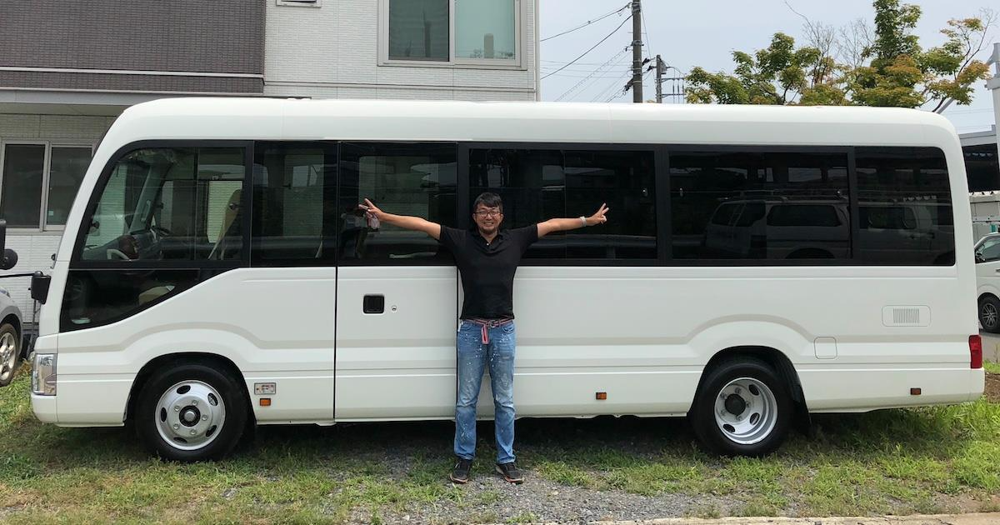{width=500}
:::
::: {.column width="50%" }
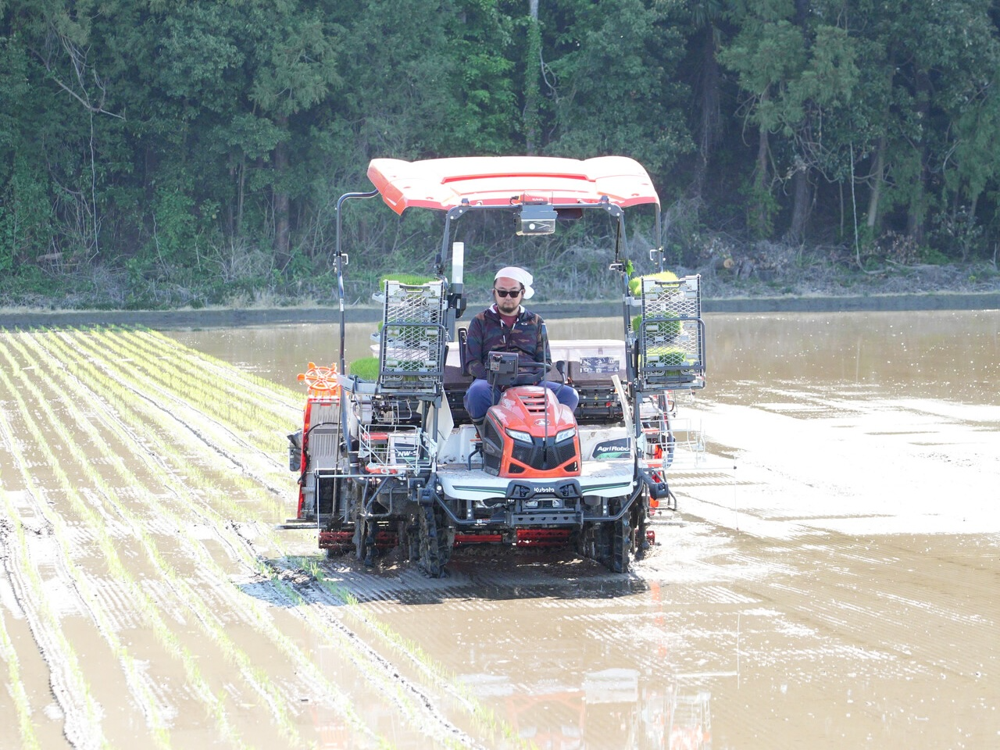{width=500}
:::
::::

---

:::: {.columns}

::: {.column width="40%"}
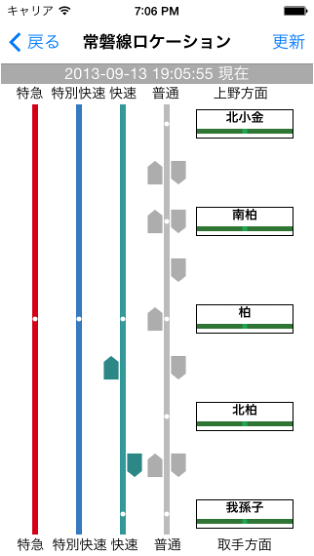
:::

::: {.column width="60%"}
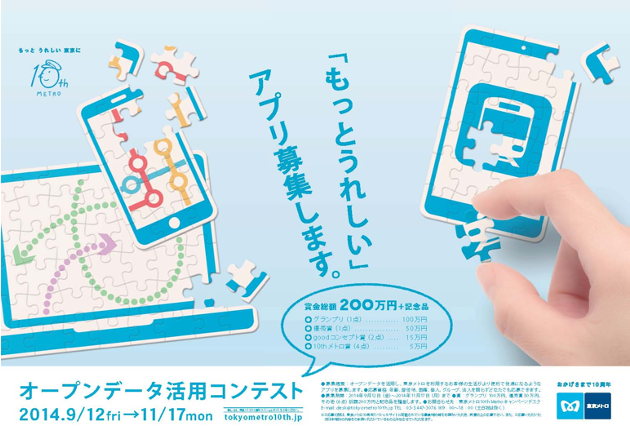{width=500}

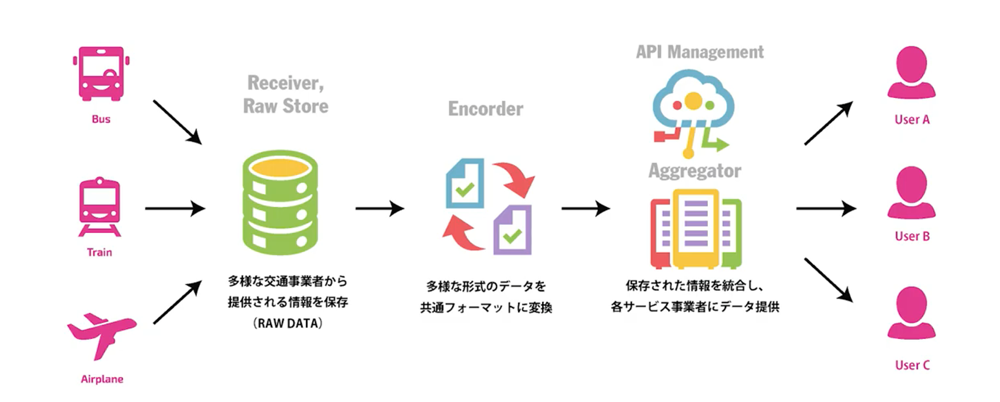{width=500}
:::

::::


## 背景・目的

- 公共交通オープンデータチャレンジ2025において、国土交通省の「ほこナビプロジェクト」より歩行空間ネットワークデータが公開された
- 本セミナーでは歩行空間ネットワークデータの概略と使用方法について解説する

**歩行空間ネットワークデータとは**

> 歩行空間ネットワークデータは、歩行経路のバリアフリーに関する情報を付与した「リンク」及びリンクの結節点である「ノード」によって構成されるデータである。

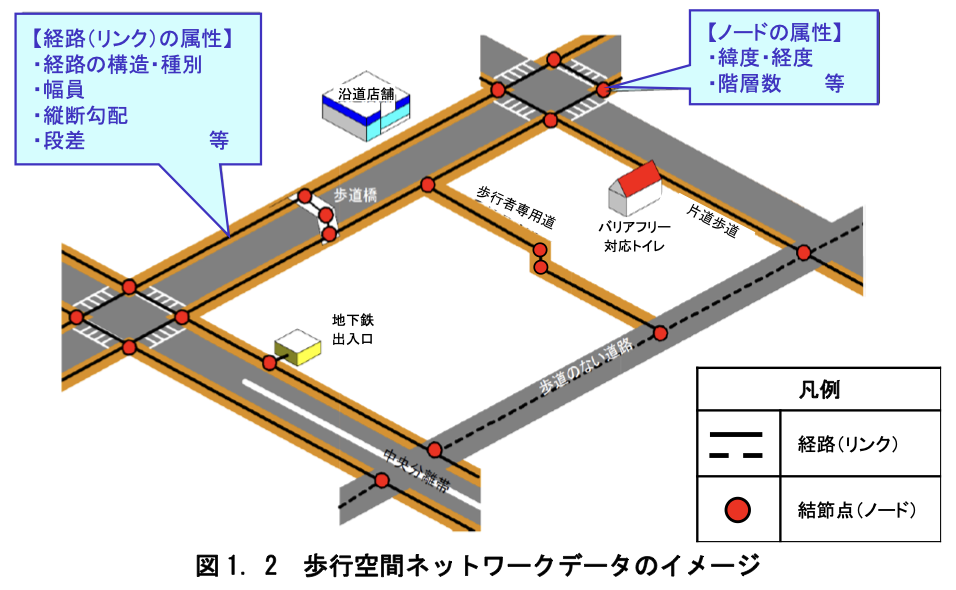

[歩行空間ネットワークデータ整備仕様 2024年7月版](https://www.mlit.go.jp/sogoseisaku/soukou/content/001757259.pdf)

## Kepler.gl

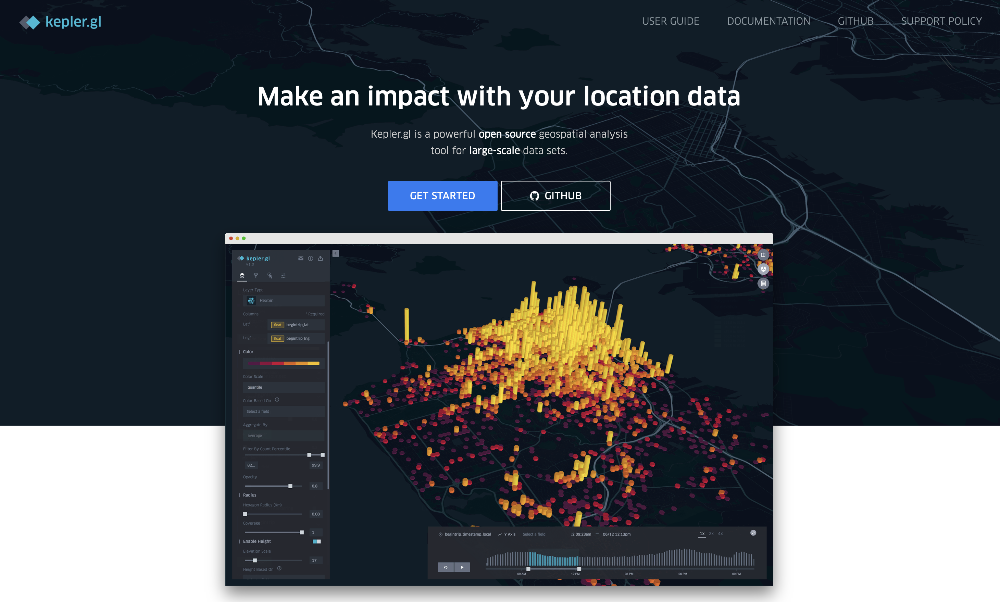

---

- **Webブラウザ上でGISデータをいい感じに可視化できるツール**
- Uberが開発したツールがOSS化されたもの
    - [deck.gl](https://deck.gl/)をベースに構築されている
- 地理情報を含んだCSVやGeoJSONを読み込んで可視化できる
    - サーバーに情報が送られるのではなく、ブラウザの中で処理されて表示される
- レイヤーを重ねて可視化できる
    - e.g. バス停勢圏のレイヤーに、夜間人口のレイヤーを重ねる
- [Forsquare Studio](https://studio.foursquare.com)という高機能なプロプライエタリ版がある
    - 元はUnfoldedというスタートアップが開発していたものをForsquareが買収
- 2025/02頃からDuckDB-Wasmが組み込まれ、読み込んだデータに対してSQLで処理した結果をダイレクトに可視化することが可能に！
    - が、先日DuckDB-Wasmのマルウェア感染が公表されたのでちょっと注意（2025/09/09時点で公開されているのはv1.28.0を使用しているので問題ないはず）

## QGIS

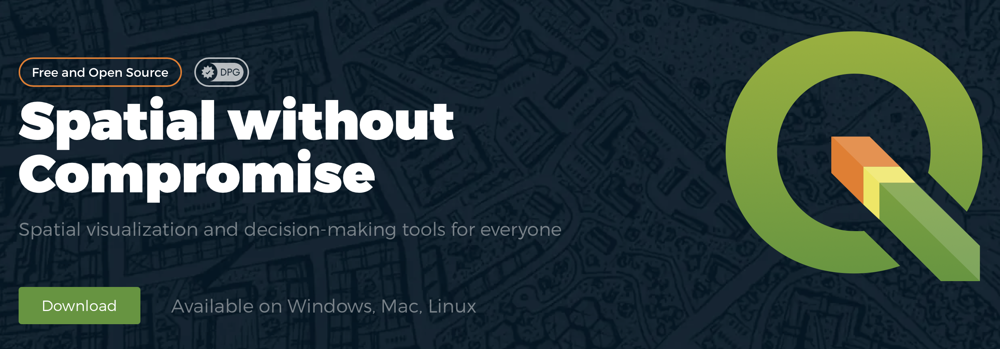{width="720px"}

---

> Giving the power of spatial visualization and decision making tools to everyone
[QGIS Web Site::Overview](https://qgis.org/project/overview/)

> QGIS（キュージーアイエス、旧称:Quantum GIS）は、地理空間情報データの閲覧、編集、分析機能を有するクロスプラットフォームのオープンソースソフトウェア・GISソフトである。
[Wikipedia::QGIS](https://ja.wikipedia.org/wiki/QGIS)

- OSSなGIS（Geographic Information System: 地理情報システム）ソフトウェア
- プロプライエタリなGISソフトといえば[ArcGIS](https://www.esrij.com/products/arcgis/)、OSSなGISソフトといえば[QGIS](https://qgis.org)
- インストール方法
    - [https://qgis.org/download/](https://qgis.org/download/)
    - [QGISを始めよう！QGISのインストール手順について紹介　〜Windows版、Mac版〜](https://qgis.mierune.co.jp/posts/howto_1_install_qgis)

## PostgreSQL+PostGIS+pgRouting

> PostGIS extends the capabilities of the PostgreSQL relational database by adding support for storing, indexing, and querying geospatial data.
[PostGIS](https://postgis.net)

- PostgreSQLを拡張し、GIS向けのデータ保管やインデクシング、空間演算のサポートを追加するモジュール

> pgRouting は地理空間における経路探索や他のネットワーク解析機能を提供するために PostGIS/PostgreSQL 地理空間データベースを拡張します。
[pgRouting](https://live.osgeo.org/ja/overview/pgrouting_overview.html)

- PostgreSQL+[PostGIS](https://postgis.net/)な環境に経路探索及びネットワーク機能を追加するモジュール
    - 最短経路探索、到達圏探索、巡回セールスマン問題などに対応
- これらをまとめて使用できる[Docker Image](https://hub.docker.com/r/pgrouting/pgrouting)が提供されている
    - ゼロから環境構築すると面倒なので特段の事情がなければ上記イメージを使用して環境を立ち上げることをお勧め

## Kepler.glを使用して歩行空間ネットワークデータを可視化してみる

1. [https://kepler-preview.foursquare.com](https://kepler-preview.foursquare.com)を開く
2. node.geojson、link.geojsonをD&Dする

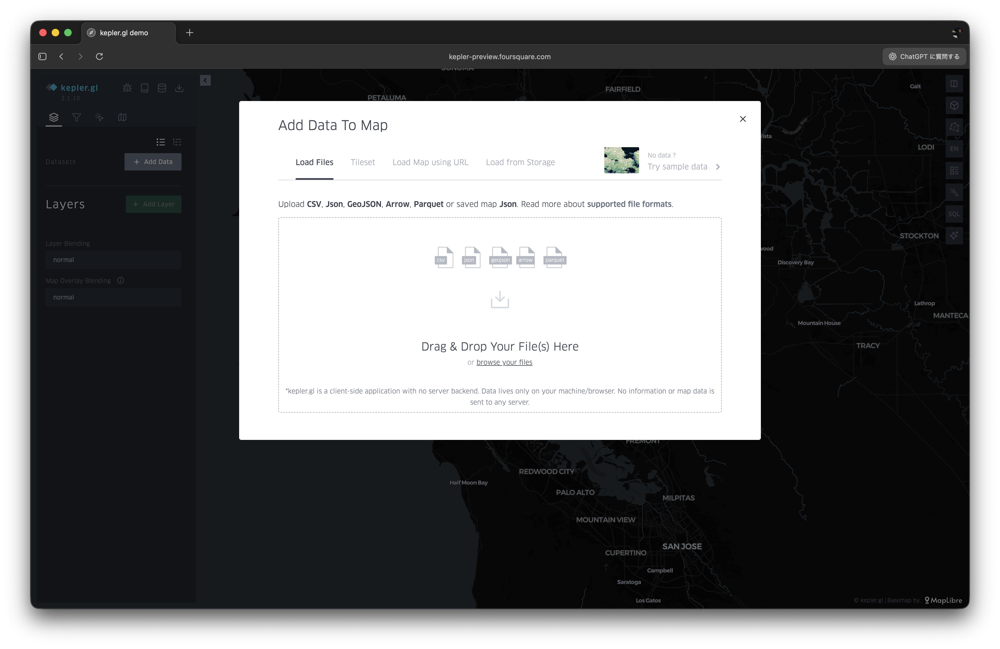{width="55%"}

---

3. 表示を調整する

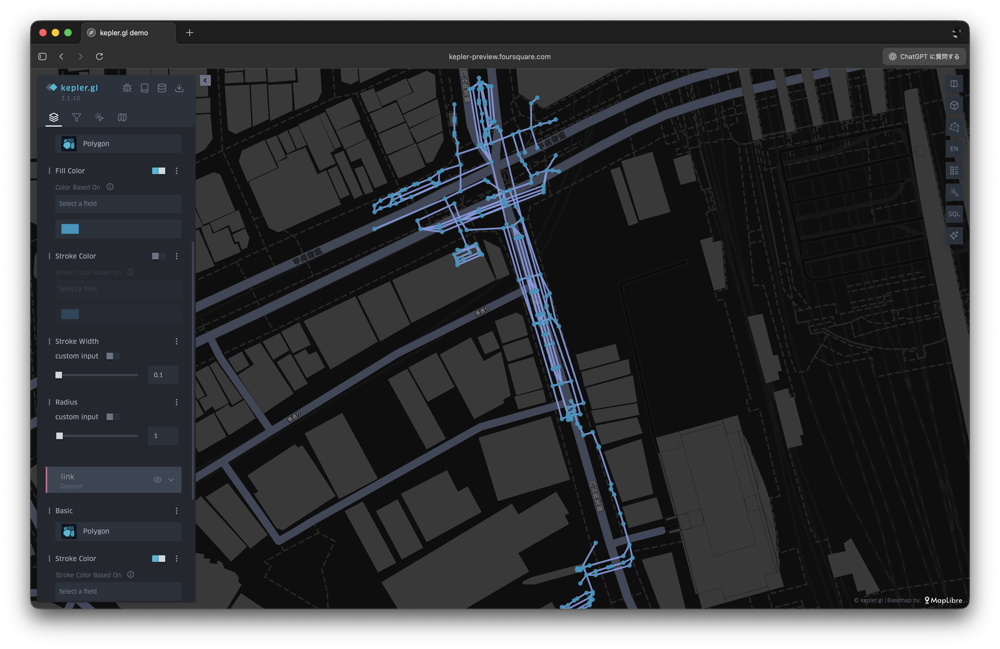{width="80%"}

---

- brail_tile: 視覚障害者誘導用ブロック等の有無
    - 1：視覚障害者誘導用ブロック等なし、2：視覚障害者誘導用ブロック等あり、<br />99：不明

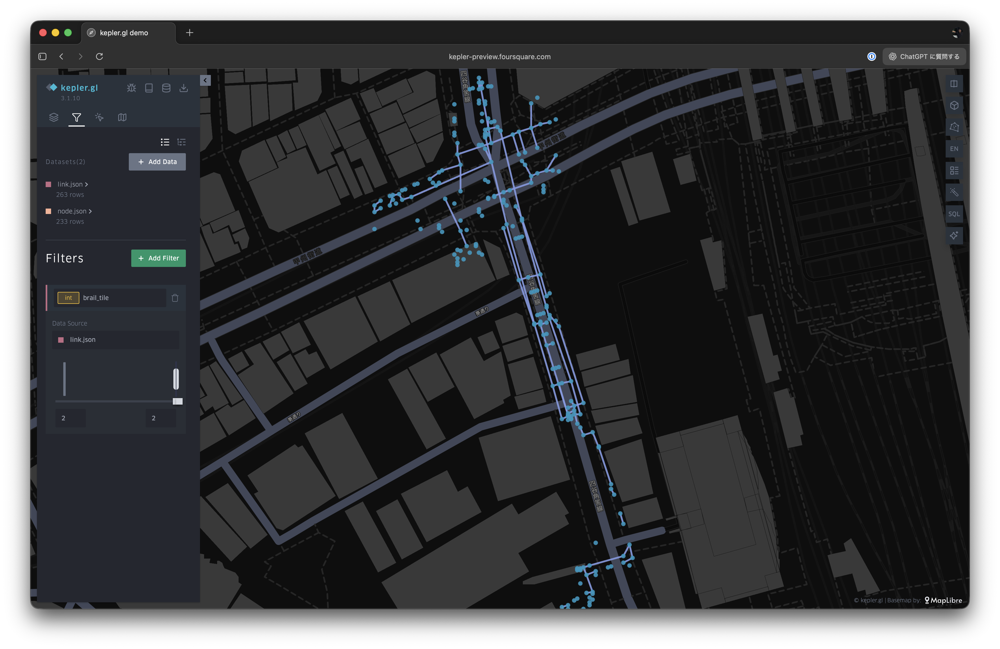

---

- lev_diff: 段差
    - 1：0cm、2：0cm より大きい～2 ㎝以下、3：2cmより大きい～5cm 以下、4：5cmより大きい～10cm以下、5：10cm より大きい、99：不明

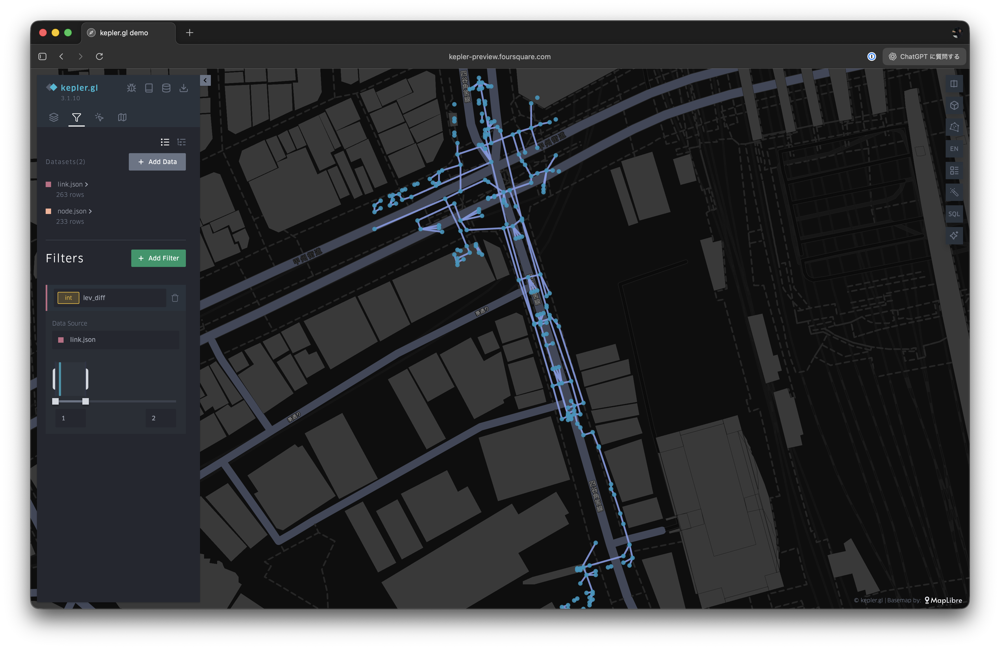

## QGISとpgRoutingを使って経路探索してみる

正確にはQGISと(PostgreSQL+PostGIS+pgRouting)を使って経路探索してみる

### Docker ContainerでpgRoutingを動かす

- Dockerをインストールする（ここでは詳細略
- 以下のコマンドでpgRoutingのコンテナを起動する

```sh 
docker run -d --name pgrouting -p 5432:5432 -v "$(pwd)/postgresql/data:/var/lib/postgresql/data" -e POSTGRES_PASSWORD=postgres pgrouting/pgrouting:17-3.5-3.8.0
```
---

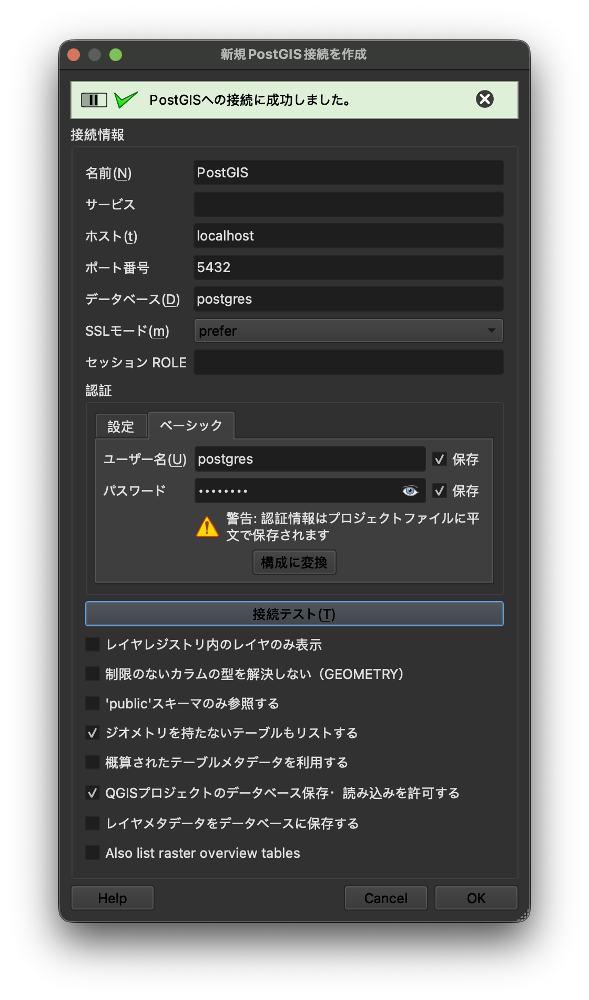

---

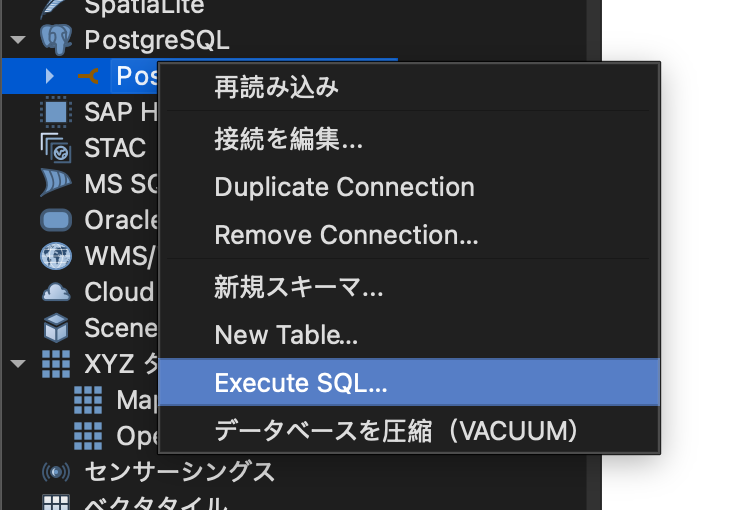

---

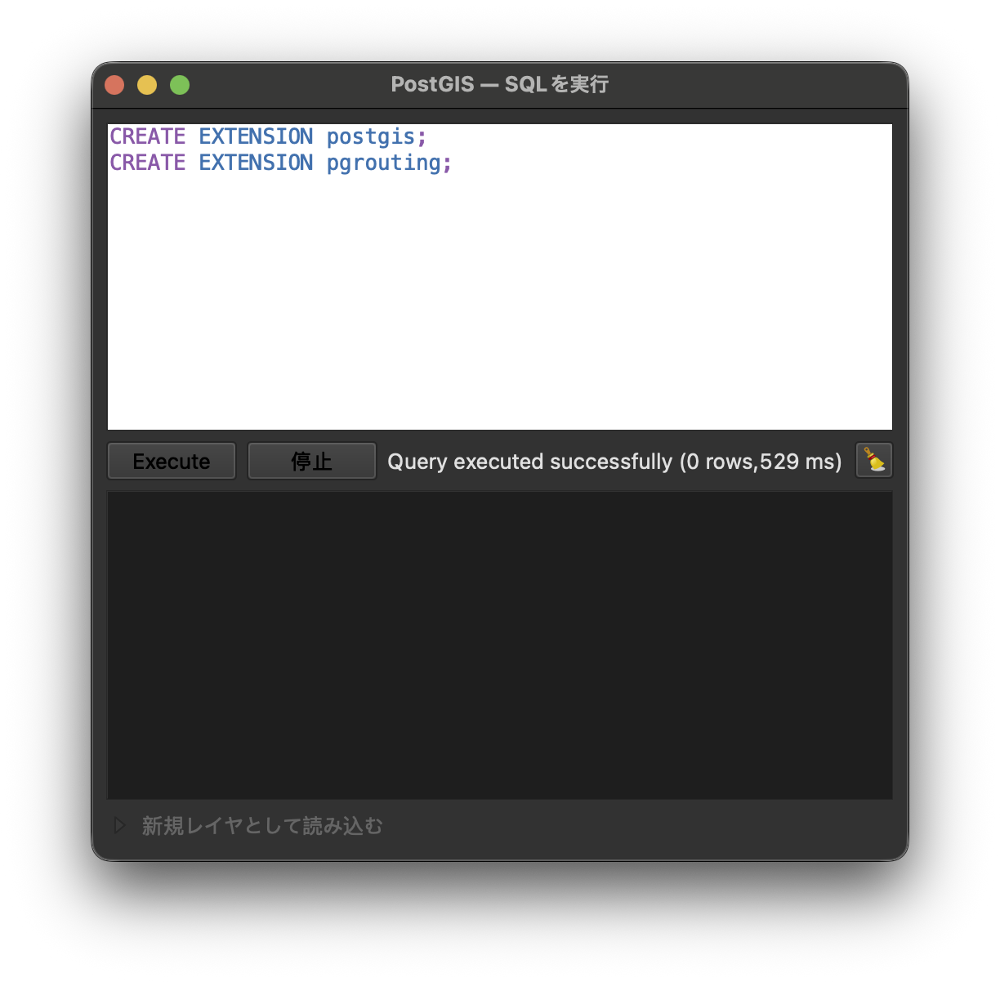

---

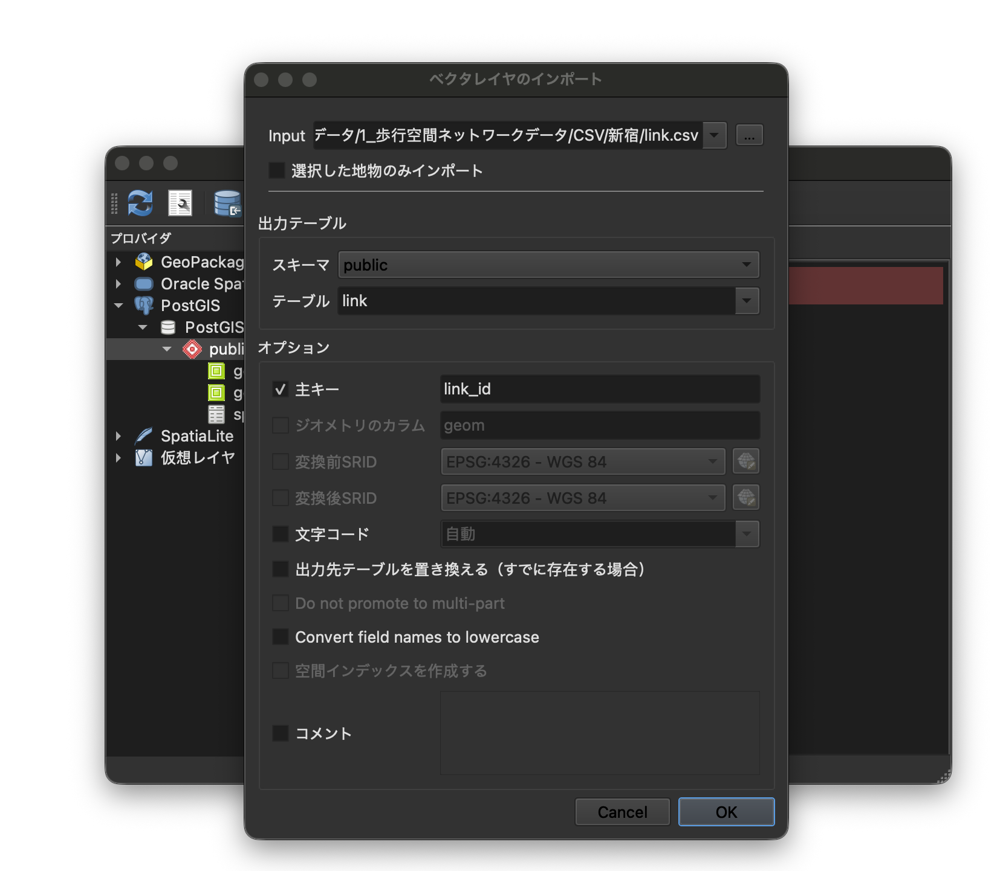

---

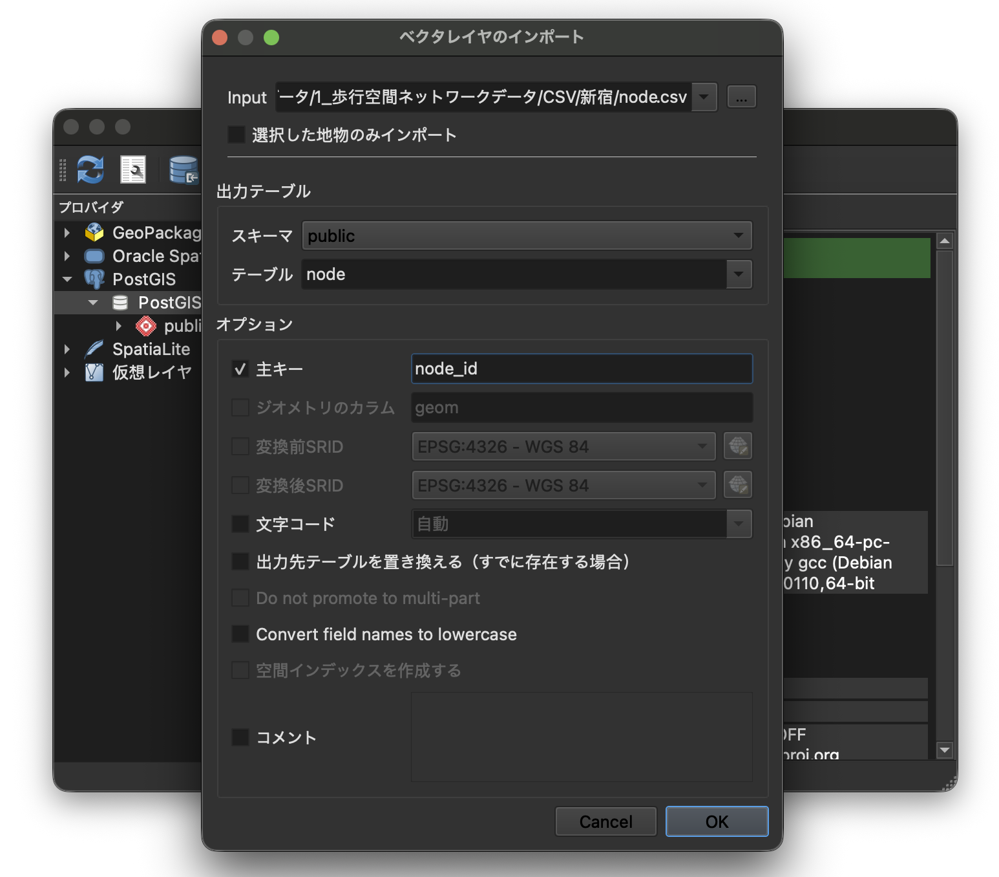

---

### 経路情報テーブルwayの生成

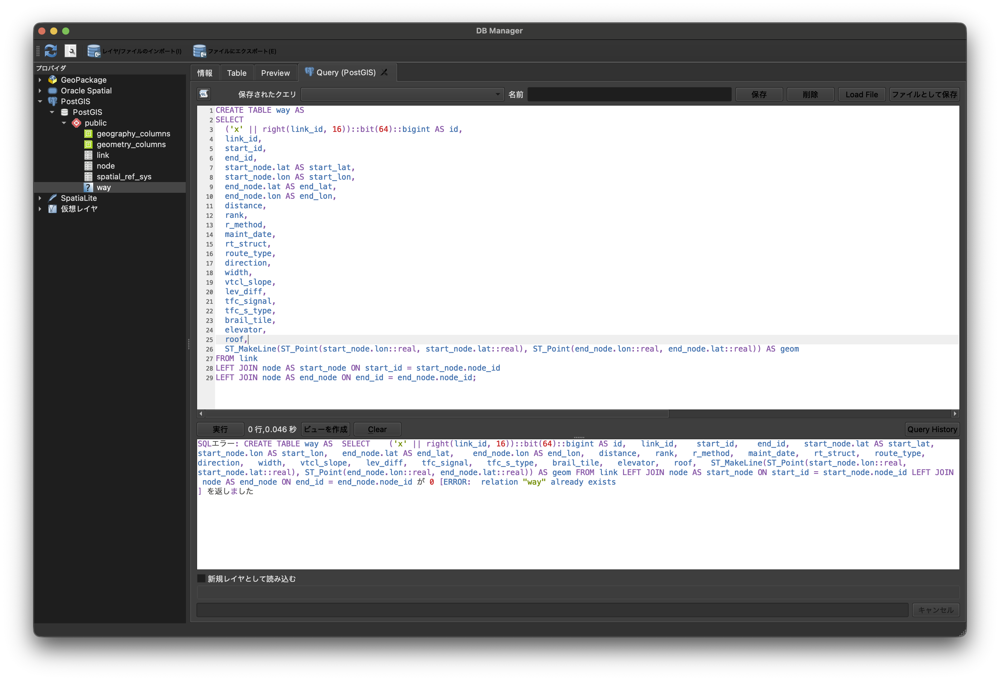

---

**経路情報テーブルway生成クエリ**

```sql
CREATE TABLE way AS 
SELECT 
  ('x' || right(link_id, 16))::bit(64)::bigint AS id,
  link_id, 
  start_id, 
  end_id,
  start_node.lat AS start_lat, 
  start_node.lon AS start_lon,
  end_node.lat AS end_lat, 
  end_node.lon AS end_lon,
  distance,
  rank,
  r_method,
  maint_date,
  rt_struct,
  route_type,
  direction,
  width,
  vtcl_slope,
  lev_diff,
  tfc_signal,
  tfc_s_type,
  brail_tile,
  elevator,
  roof,
  ST_MakeLine(ST_Point(start_node.lon::real, start_node.lat::real), ST_Point(end_node.lon::real, end_node.lat::real)) AS geom
FROM link
LEFT JOIN node AS start_node ON start_id = start_node.node_id
LEFT JOIN node AS end_node ON end_id = end_node.node_id;
```

---

### トポロジーテーブル verticesの生成

- トポロジーテーブル: 経路のつながり情報テーブル
- pgRoutingの使い方を調べるとpgr_createTopology()を使う方法が出てくるが、この方法はVer.3.8以降からDepricatedになっているのでpgr_extractVertices()を使用する

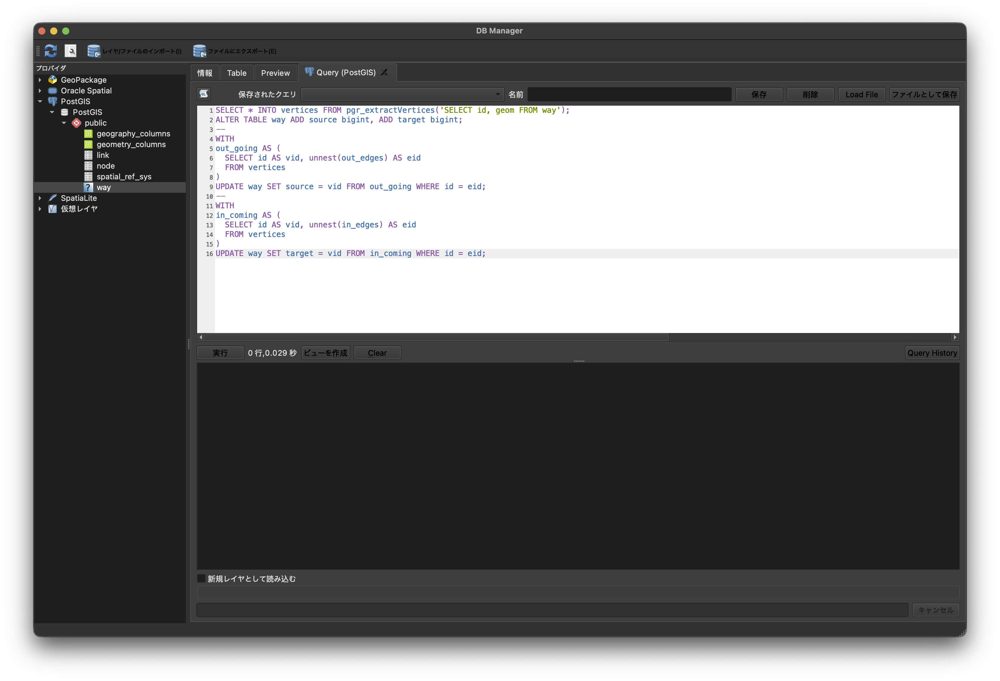

---

**トポロジーテーブル vertices生成クエリ**
```sql
SELECT * INTO vertices FROM pgr_extractVertices('SELECT id, geom FROM way');
ALTER TABLE way ADD source bigint, ADD target bigint;
--
WITH
out_going AS (
  SELECT id AS vid, unnest(out_edges) AS eid
  FROM vertices
)
UPDATE way SET source = vid FROM out_going WHERE id = eid;
--
WITH
in_coming AS (
  SELECT id AS vid, unnest(in_edges) AS eid
  FROM vertices
)
UPDATE way SET target = vid FROM in_coming WHERE id = eid;
```

---

### 最短経路探索の実施

- pgRoutingでは複数の最短経路探索アルゴリズムを使用できるが、今回はオーソドックスなダイクストラ法で実施

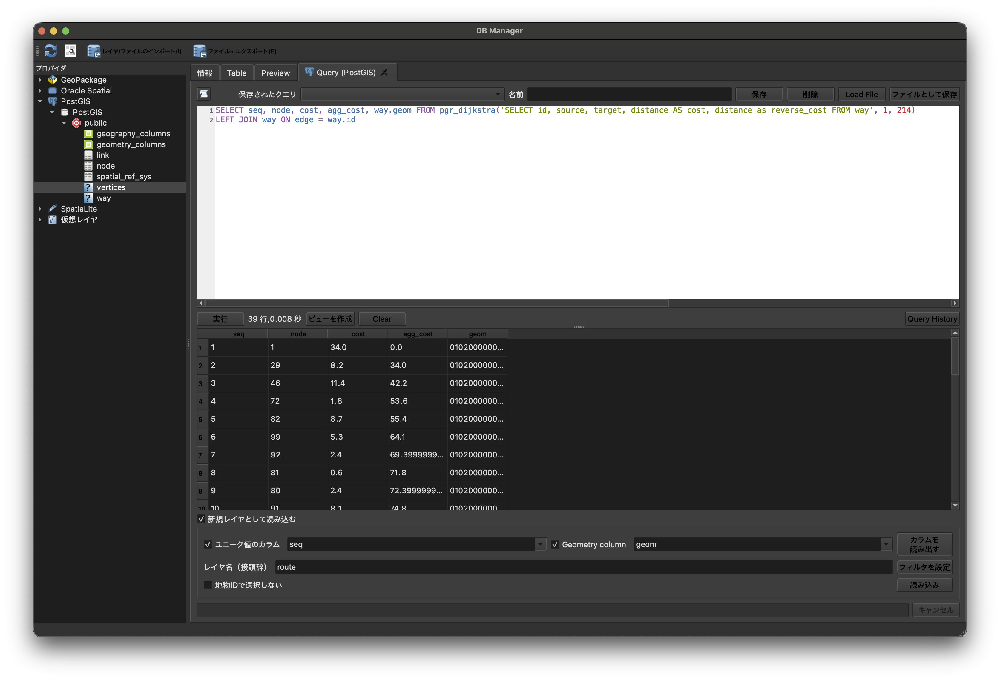

---

**最短経路の可視化**
```sql
SELECT seq, node, cost, agg_cost, way.geom FROM pgr_dijkstra('SELECT id, source, target, distance AS cost, distance as reverse_cost FROM way', 1, 214)
LEFT JOIN way ON edge = way.id
```
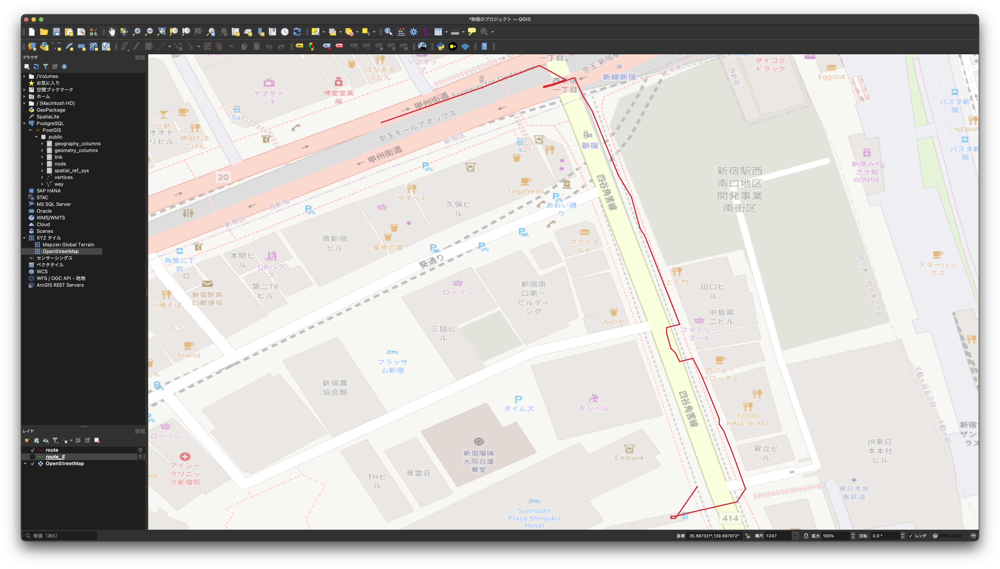

---

### 応用：　段差の小さな経路の探索

- 車椅子で昇り降りができる段差＝2cm以内
- この制約条件で経路探索を行うにはどうすればいいか？
    - => 2cmより大きな段差を持つ経路を除いて探索を行う
    - => ランク区分を考慮して経路を絞り込む

---

**応用: 段差2cm以下の最短経路**
```sql
SELECT seq, node, cost, agg_cost, way.geom FROM pgr_dijkstra('SELECT id, source, target, distance AS cost, distance as reverse_cost FROM way WHERE rank ~ ''^..S$''', 1, 214)
LEFT JOIN way ON edge = way.id
```

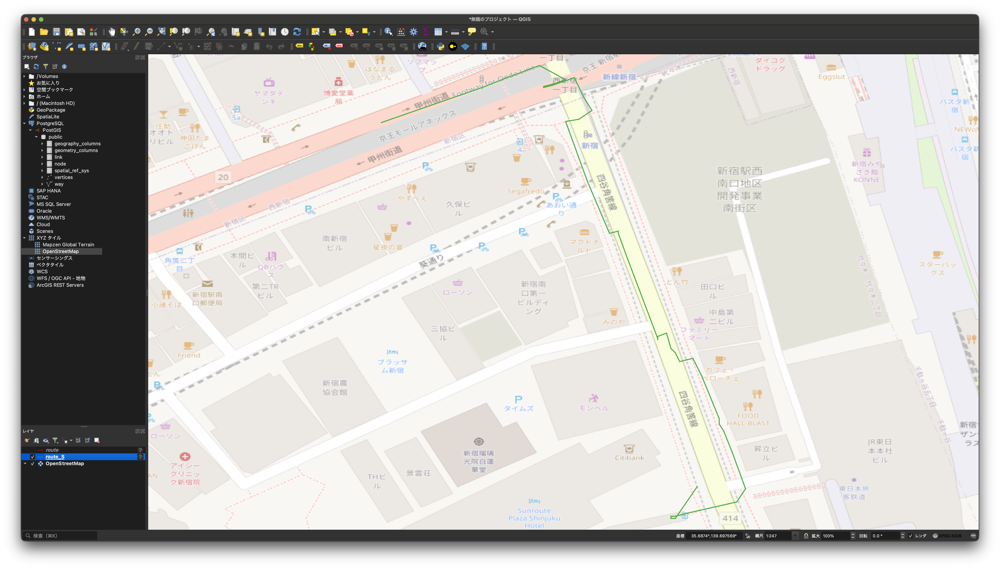

## まとめ

- 歩行空間ネットワークデータの概略と使用方法について解説
    - Kepler.glを用いた可視化
    - QGIS+pgRoutingを用いた経路探索
- バリアフリールートの生成などに応用可能
- 屋内地図と組み合わせ、今後は配送ロボット向けに使用する可能性も考えられる
    - それに向けたアプリケーションの検討には非常に有効なデータと言える
- 屋内地図の仕様も活発に検討されているので、そちらとの組み合わせも考えたい
    - IMDF: https://register.apple.com/resources/imdf/
    - OSM Simple Indoor Tagging: https://wiki.openstreetmap.org/wiki/Simple_Indoor_Tagging
